# Repositório

[Tópicos Avançados em Inteligência Computacional 2](https://github.com/Manuelfjr/topicos_avancados_ic_ii/tree/develop)

# Projeto 01

**[Interpretabilidade de Modelos]**


descrição:

1. Escolha uma base de dados do seu interesse e construa modelos preditivos.

2. Trabalhe agora com os aspectos de interpretabilidade principais explorados em sala. Discuta o que o modelo aprendeu, como ele realiza suas predições, quais as variáveis mais importantes,... dentre outros aspectos que ajude a entender o comportamento do modelo enquanto realiza suas predições.   

Obs.: a entrega será feita como um notebook comentado com os insights obtidos. Mais que gerar gráficos e estatísticas, é importante que se analise os resultados obtidos e que se apontem as conclusões mais importantes.

Obs.: será feita uma apresentação rápida em sala (10 a 15 minutos por pessoa, em ordem definida em sorteio), mas a entrega do relatório será uniforme (no dia 17 de abril até as 13h).

# Introdução

O conjunto utilizado para o trabalho, será o mesmo das atividades anteiores, *Breast Cancer  Wisconsin*. As variáveis estão sendo descritas abaixo.
* **dataset**:  Breast cancer wisconsin (diagnostic)

* **Attribute Information**:
    - radius (mean of distances from center to points on the perimeter)

    - texture (standard deviation of gray-scale values)

    - perimeter

    - area

    - smoothness (local variation in radius lengths)

    - compactness (perimeter^2 / area - 1.0)

    - concavity (severity of concave portions of the contour)

    - concave points (number of concave portions of the contour)

    - symmetry

    - fractal dimension (“coastline approximation” - 1)

The mean, standard error, and “worst” or largest (mean of the three worst/largest values) of these features were computed for each image, resulting in 30 features. For instance, field 0 is Mean Radius, field 10 is Radius SE, field 20 is Worst Radius.

* **class**:
    - WDBC-Malignant (0)
    - WDBC-Benign (1)

Durante o decorrer do trabalho, será replicado as aplicações desenvolvidas nas ultimas atividades, retirando as devidas interpretações dos resultados obtidos.

---
# 0. Configurações

## 0.1 Imports

In [1]:
from nb_utils import set_root

PROJECT_DIR = set_root(level=2, return_path=True)

ModuleNotFoundError: No module named 'nb_utils'

In [104]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.datasets import load_breast_cancer, make_circles
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import PartialDependenceDisplay, permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (RocCurveDisplay, accuracy_score, auc,
                             confusion_matrix, f1_score,
                             precision_recall_curve, precision_score,
                             recall_score, roc_auc_score)
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier, plot_tree
from tqdm import tqdm

from src.models.lime import LimeExplainer
from src.models.surrogates import ModelSurrogates
from src.utils.metrics import calculate_metrics
from src.utils.plot import (create_pdp_subplots, generate_color_range,
                            plot_bar_chart, plot_heatmap, plot_results,
                            plot_simulation_results)

warnings.filterwarnings('ignore')

## 0.2 Parameters

In [110]:
path_assets = PROJECT_DIR / "assets"
ext_type_fig = "png"

_fig_params = {
    "format": ext_type_fig,
    "dpi": 400
}

n_seed = 2024
n_seed_atv4 = 24
n_seed_pfi = 42
cv = 10
n_repeats = 30

In [111]:
target = "label"
content = load_breast_cancer()
features = list(content["feature_names"])

In [112]:
params = {
    "holdout": {
        "test_size": 0.3,
        "random_state": 2024
    }
}

In [113]:
black_box = {
    "rf": RandomForestClassifier(random_state=n_seed),
    "svc": SVC()
}
white_box = {
    "dt1": DecisionTreeClassifier(max_depth=1, random_state=n_seed),
    "dt2": DecisionTreeClassifier(max_depth=2, random_state=n_seed),
    "dt3": DecisionTreeClassifier(max_depth=3, random_state=n_seed)
}

In [114]:
models = {
    "dt": DecisionTreeClassifier(
        max_depth=2,
        min_samples_leaf=30,
        criterion='entropy'
    ),
    "rf": RandomForestClassifier(),
    "lr": LogisticRegression(
        max_iter=1000
    ),
    "nb": GaussianNB(),
    "knn": KNeighborsClassifier(n_neighbors=3)
}

In [115]:
_names = {
    "rf": "RandomForestClassifier",
    "dt": "DecisionTreeClassifier",
    "lr": "LogisticRegression",
    "knn": "KNeighborsClassifier",
    "nb": "NaiveBayes",
    "svc": "SVC",
    "dt1": r"DecisionTreeClassifier\_max-depth=1",
    "dt2": r"DecisionTreeClassifier\_max-depth=2",
    "dt3": r"DecisionTreeClassifier\_max-depth=3"
}

In [116]:
which_metrics = {
    "Acc": accuracy_score,
    "Prec": precision_score,
    "Rec": recall_score,
    "F1": f1_score,
    "AUC": roc_auc_score
}

In [117]:
tick_params = {
    "axis": 'both',
    "which": 'both',
    "bottom": False,
    "top": False,
    "left": False,
    "right": False,
    "labelbottom": False,
    "labelleft": False
}

In [118]:
lower_color_name = 'blue'
upper_color_name = 'red'

---

# 1. Seleção de modelos


Durante essa seção, será aplicado  um conjunto de algoritmos supervisionados, com o intuito de classificar corretamente o tipo do cancer de um individuo, se é Maligno (0) ou Benigno (1). Será treinado um conjunto de algoritmos, utilizando inicialmente o método do *holdout*, selecionando o melhor modelo, além de exibir inicialmente uma arvore compacta de 2 níveis.

## 1.1 Modelos e métricas

Durante o decorrer da atividade, será aplicado métodos supervisionados, sendo eles:

* *Decision Tree*;

* *Random Forest*.

* *Regressão Logística*; 

* *Naive Bayes*;

* *kNN*.


Algumas métricas serão obtidas ao decorrer do experimento, sendo elas:

```py
from sklearn.metrics import confusion_matrix # matriz de confusão para visualização dos outputs
from sklearn.metrics import accuracy_score # acuracia
from sklearn.metrics import precision_score # precisão
from sklearn.metrics import recall_score # recall
from sklearn.metrics import f1_score # f1-score
from sklearn.metrics import roc_auc_score # curva roc
from sklearn.metrics import precision_recall_curve # curva da precisão versus recall
from sklearn.metrics import auc # valor da area sob a curva
```

## 1.2 Preparando dataset

### 1.2.1 Process dataset

In [119]:
data = pd.DataFrame(
    content["data"],
    columns=features
)
data[target] = content["target"]
data.columns = (
    data
    .columns
    .str.replace(" ", "_")
    .str.replace("(", "")
    .str.replace(")", "")
)

### 1.2.2 Split

In [120]:
X = data.drop(target, axis=1).copy()
y = data[target].values

### 1.2.3 Holdout


aplicação do processo de holdout, considerando um tamanho de teste de `30%`

In [121]:
X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    **params["holdout"]
)

## 1.3 Modelagem

### 1.3.1 Fit

In [122]:
preds = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    preds[name] = {
        "y_true": y_test,
        "y_pred": model.predict(X_test)
    }

### 1.3.2 Metrics

In [123]:
metrics = pd.DataFrame(index=preds.keys(), columns=which_metrics.keys())
for m, metric in which_metrics.items():
    for name, model in models.items():
        if m == "Acc":
            metrics.loc[name, m] = float(metric(**preds[name]))
        elif (m != "Acc") and (m != "AUPR") and (m != "AUC"):
            metrics.loc[name, m] = float(metric(**preds[name], pos_label=1))
        elif m == "AUC":
            metrics.loc[name, m] = float(
                roc_auc_score(
                    preds[name]["y_true"],
                    model.predict_proba(X_test)[:, 1]
                )
            )
        elif m == "AUPR":
            precision, recall, thresholds = precision_recall_curve(
                preds[name]["y_true"],
                model.predict_proba(X_test)[:, 1],
                pos_label='yes'
            )
            metrics.loc[name, m] = float(auc(recall, precision))
    metrics[m] = metrics[m].astype(float)

### 1.3.3 Overview

In [124]:
metrics.index = metrics.reset_index()["index"].replace(_names).values

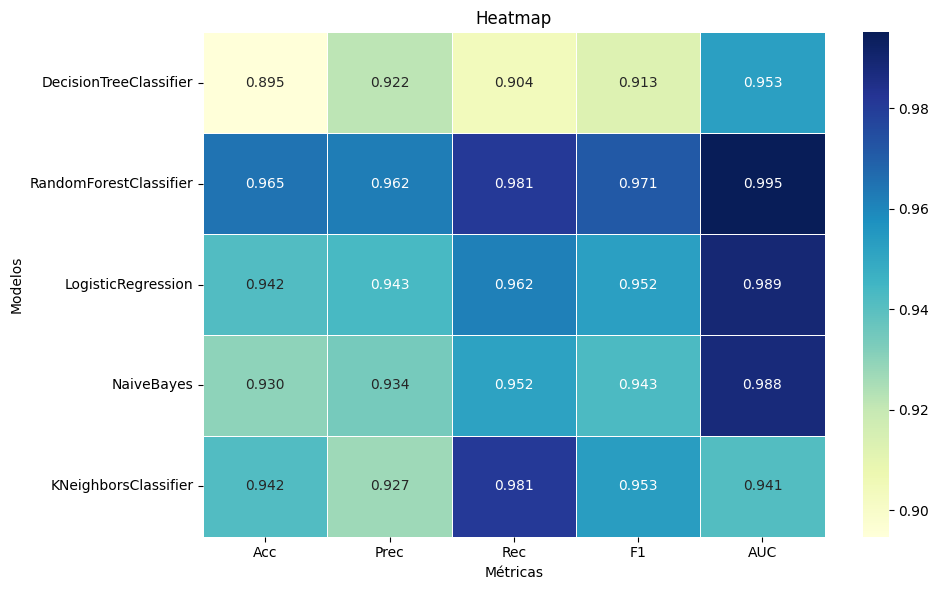

In [125]:
fig_hm, axes_hm = plt.subplots(1, 1, figsize=(10, 6))
sns.heatmap(metrics, annot=True, cmap='YlGnBu', fmt=".3f", linewidths=.5, ax=axes_hm)
axes_hm.set_title('Heatmap')
axes_hm.set_xlabel('Métricas')
axes_hm.set_ylabel('Modelos')
fig_hm.tight_layout()
fig_hm.savefig(
    path_assets / "atv-01_heatmap_metrics.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

Podemos notar que o modelo *Random Forest Classifier* apresentou, em geral, melhores métricas, com exceção do recall, aonde o *KNN* se destacou com um valor de `0.981`.

### 1.3.4 Matriz de confusão

In [126]:
n_col = 2
if len(models.keys()) % 2 == 0:
    n_row = len(models.keys()) // n_col
else:
    n_row = (len(models.keys()) // n_col) + 1

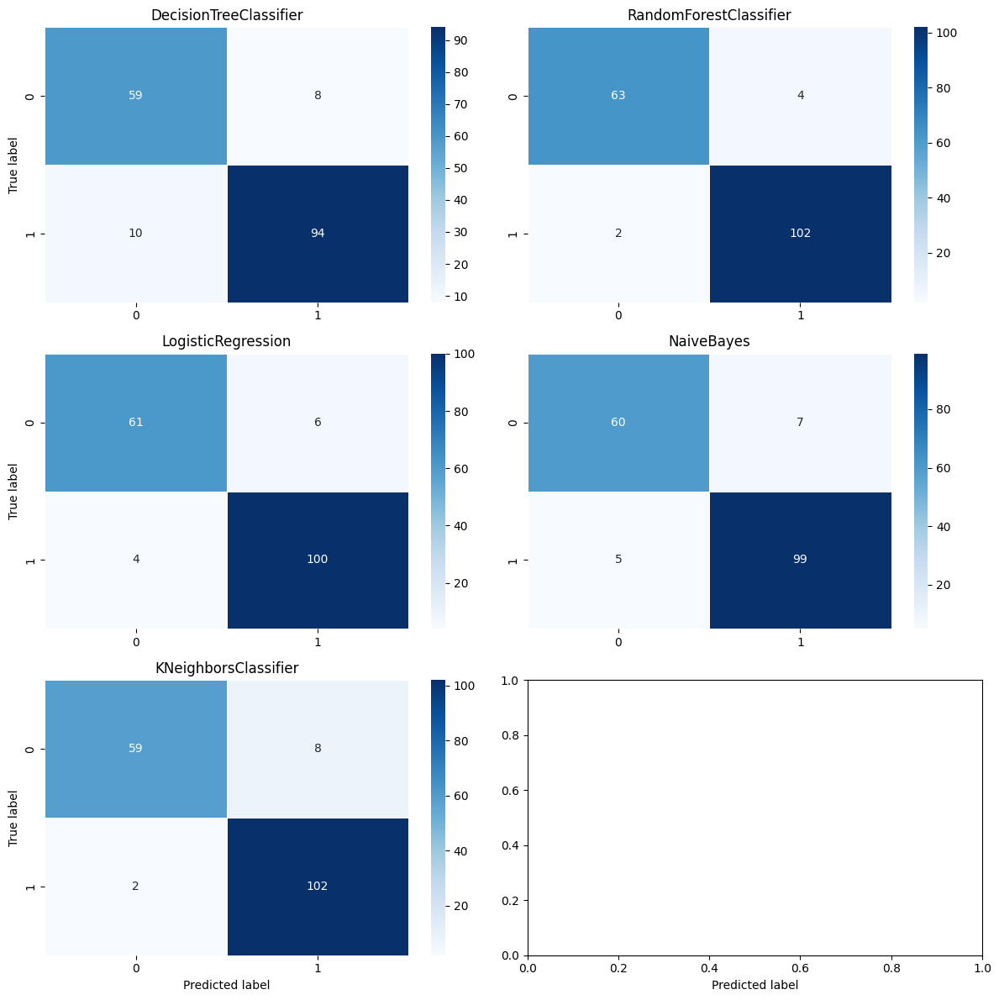

In [127]:
fig_cm, axes = plt.subplots(n_row, n_col, figsize=(12, 12))

axes = axes.flatten()
for idx, ((name, model), ax) in enumerate(zip(models.items(), axes)):
    cm = confusion_matrix(y_test, preds[name]["y_pred"], labels=models[name].classes_)

    sns.heatmap(
        cm,
        annot=True,
        cmap="Blues",
        fmt="d",
        linewidths=.5,
        ax=ax
    )
    ax.set_title(name.replace(name, _names[name]))
    if idx == len(models.items()) - 1:
        ax.set_xlabel('Predicted label')
        if len(models.items()) % 2 != 0:
            axes[-1].set_xlabel('Predicted label')
    if idx % 2 == 0:
        ax.set_ylabel('True label')
    plt.close()
fig_cm.tight_layout()
fig_cm.savefig(
    path_assets / "atv-01_heatmap_cm.{}".format(ext_type_fig),
    **_fig_params
)
fig_cm

Ao olharmos apenas para a classe positiva, o modelo que mais se destacou foi o *KNN* contudo apresentou maiores valores de falso positivo. Em termos gerais e quanto a balanceamento geral das classificações, o modelo *Random Forest* se destacou novamente ao olharmos diretamente para a matriz de confusão.

### 1.3.5 Arvore compacta



Como os modelos ja foram treinados, podemos obter a arvore compacta mais facilmente.

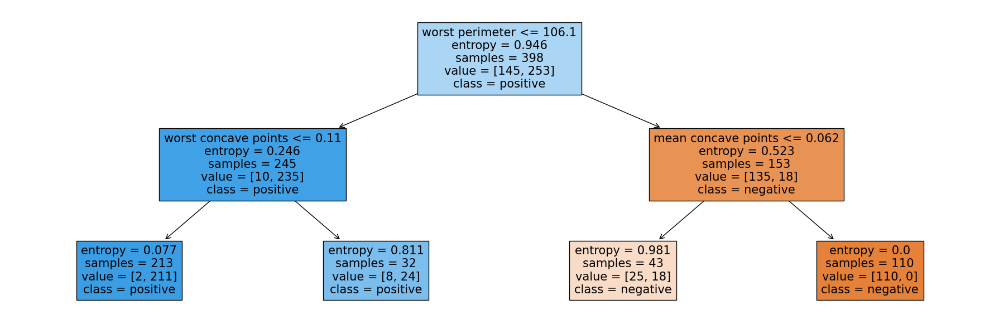

In [128]:
fig_dt, axes = plt.subplots(1, 1, figsize=(18, 6))
plot_tree(
    models["dt"],
    feature_names=features,
    class_names=['negative', "positive"],
    filled=True,
    ax=axes
)
fig_dt.tight_layout()
fig_dt.savefig(
    path_assets / "atv-01_dt.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

Ao olharmos a arvore compacta, podemos notar que a variável *Worst Perimeter é bem impactante na hora de separação entre as classes positivas das negativas. Em segundo nivel, podemos notar que a variavel *Worst Concave Points*, ao olhar para a classe positiva, é possivel notalr um baixo grau de entropia, conseguindo ser usada de forma significante para separar a classe das demais.

### 1.3.6 Curva ROC

Ao olharmos a arvore compacta, podemos notar que a variável *Worst Perimeter é bem impactante na hora de separação entre as classes positivas das negativas. Em segundo nivel, podemos notar que a variavel *Worst Concave Points*, ao olhar para a classe positiva, é possivel notalr um baixo grau de entropia, conseguindo ser usada de forma significante para separar a classe das demais.

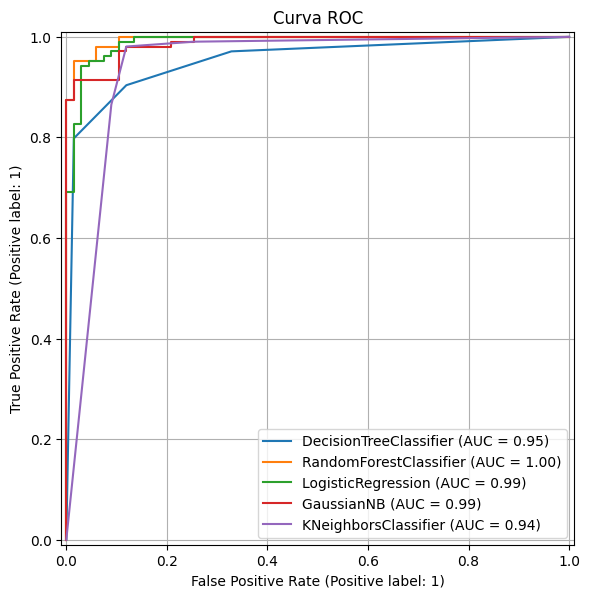

In [129]:
fig_roc, axes = plt.subplots(1, 1, figsize=(6, 8))
plt.tight_layout()
for name, model in models.items():
    RocCurveDisplay.from_estimator(model, X=X_test, y=y_test, ax=axes)
axes.grid()
axes.set_title("Curva ROC")
fig_roc.tight_layout()
fig_roc.savefig(
    path_assets / "atv-01_roc-auc.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

## 1.4 Cross-validation

In [130]:
num_folds = 10
cv_scores = {}
for name, model in tqdm(models.items()):
    cv_scores[name] = {}
    for i in ["accuracy", "recall", "precision", "f1", "roc_auc"]:
        scores = cross_val_score(model, X, y, cv=num_folds, scoring=i)
        cv_scores[name][i] = scores.mean()

100%|██████████| 5/5 [00:41<00:00,  8.25s/it]


In [131]:
cv_results = pd.DataFrame(cv_scores)
cv_results.rename(columns=_names)

,DecisionTreeClassifier,RandomForestClassifier,LogisticRegression,NaiveBayes,KNeighborsClassifier
accuracy,0.892857,0.966635,0.950815,0.936779,0.926190
recall,0.927302,0.977460,0.972143,0.966270,0.958016
precision,0.911139,0.970400,0.952119,0.935949,0.928438
f1,0.915994,0.970843,0.961436,0.950494,0.942189
roc_auc,0.964650,0.990328,0.993387,0.988441,0.950248


## 1.5 Conclusões

|                    | **DecisionTreeClassifier** | **RandomForestClassifier** | **LogisticRegression** | **NaiveBayes** | **KNeighborsClassifier** |
|--------------------|------------------------|-------------------------|--------------------|------------|----------------------|
| **accuracy**           |         0.892857       |         0.963127        |      0.950815      |  0.936779  |       0.926190       |
| **recall**             |         0.927302       |         0.980317        |      0.972143      |  0.966270  |       0.958016       |
| **precision**          |         0.911139       |         0.965268        |      0.952119      |  0.935949  |       0.928438       |
| **f1**                 |         0.915994       |         0.974951        |      0.961436      |  0.950494  |       0.942189       |
| **roc_auc**            |         0.963724       |         0.991792        |      0.993387      |  0.988441  |       0.950248       |


Por fim, ao analisarmos apenas a área sob a *Curva ROC* (4.), podemos notar que existe um empate entre os modelos *Random Forest, Logistic Regression* e *GaussianNB (Naive Bayes considerando a verossimilhanca seguindo uma Gaussiana)*, empate técnico quando olhamos o gráfico acima, mas ao olharmos a seção (2.3) do material, é possivel notar o destaque do *Random Forest*.

Ao compararmos as métricas anteriores, o modelo mais balanceado em termos gerais das métricas, é o *Random Forest*, lembrando o *heatmap* da seção (2.3), o modelo desempenhou superiormente com respeito as outras métricas, ainda que em geral, os modelos desempenharam de forma bem semelhante para o cenário do conjunto de dados *Breast Cancer*.

Por fim, ao olharmos para os resultados apos a validação cruzada, considerando um numero de folds de 10, podemos notar que o em termos de generalização, o modelo Random Forest apresentou os melhores resultados.

---
# 2. Surrogates

Nesta seção será utilizado o método de *Global surrogate*, aonde iremos utilizar um model caixa branca *Decision Tree*, variando a profundidade da arvore entre 1 e 3, com o intuito de analisar a aproximação com o modelo caixa preta; e para modelo caixa preta, serão considerados o *Random Forest* e o *SVC*.

## 2.1 Modelagem

### 2.1.1 Fit *black-box* and *white-box* (sem aplicar PCA)


Será treinado o modelo sem aplicar o PCA, para ser possivel uma interpretação direta das variaveis apartir do *white-box* ao final.

In [132]:
ms = ModelSurrogates(white_box, black_box)
white_box_models, black_box_models, white_yhat, black_yhat = ms.fit(
    X_train,
    y_train,
    X_test
)

### 2.1.2 Aplicando *PCA*


Será aplicado o método do *PCA* aoenas representar os dados em $\mathbb{R}^{2}$ e a comparação do método *black box* com o *surrogate*

In [133]:
pca = PCA(2)
pca.fit(X_test)
X_pca = pca.transform(X_test)

### 2.1.3 Gráficos

In [ ]:
_X = pca.transform(X)

In [134]:
fig_bc, axes_bc = plt.subplots(
    len(black_yhat.keys()),
    len(white_box_models.keys()) + 1,
    figsize=(26, 8)
)
plt.close()

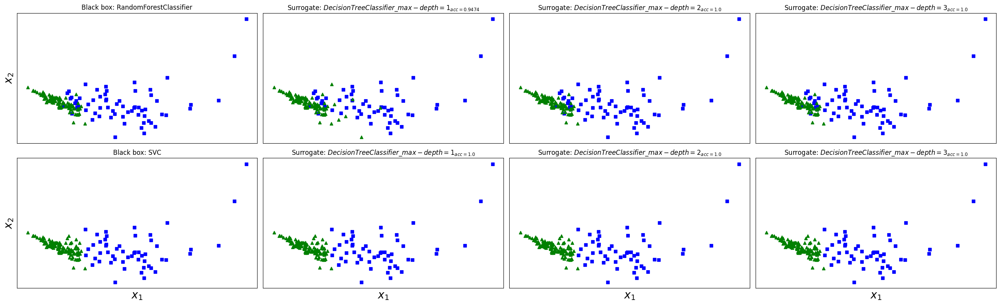

In [135]:
if axes_bc.shape == ((len(white_box_models.keys()) + 1), ):
    axes_bc = np.array([axes_bc])
for bidx, (b_name, b_yhat) in enumerate(black_yhat.items()):
    axes_bc[bidx, 0].plot(
        X_pca[:, 0][b_yhat == 0], X_pca[:, 1][b_yhat == 0], "bs"
    )
    axes_bc[bidx, 0].plot(
        X_pca[:, 0][b_yhat != 0], X_pca[:, 1][b_yhat != 0], "g^"
    )
    for widx, (w_name, w_model) in enumerate(white_yhat.items()):
        axes_bc[bidx, widx + 1].plot(
            X_pca[:, 0][w_model[b_name] == 0], X_pca[:, 1][w_model[b_name] == 0], "bs"
        )
        axes_bc[bidx, widx + 1].plot(
            X_pca[:, 0][w_model[b_name] != 0], X_pca[:, 1][w_model[b_name] != 0], "g^"
        )
        axes_bc[bidx, widx + 1].tick_params(**tick_params)
        text = f"Surrogate: ${_names[w_name]}"
        text += "_{acc="
        text += f"{round(accuracy_score(b_yhat, w_model[b_name]), 4)}"
        text += "}$"
        axes_bc[bidx, widx + 1].set_title(text)

    axes_bc[bidx, 0].tick_params(**tick_params)
    axes_bc[bidx, 0].set_ylabel(r"$x_2$", fontsize=20)
    if bidx == len(black_yhat.items()) - 1:
        for ax in axes_bc[bidx, :]:
            ax.set_xlabel(r"$x_1$", fontsize=20)
    axes_bc[bidx, 0].set_title(f"Black box: {_names[b_name]}")
fig_bc.tight_layout()
fig_bc.savefig(
    path_assets / "atv-03_surrogates.{}".format(ext_type_fig),
    **_fig_params
)
fig_bc

### 2.1.4 Overview

Acima, temos os gráficos em $\mathbb{R}^{2}$ do conjunto de dados sob o connjunto de teste colorido por seus respectivos labels. A primeira linha de gráficos trata-se do modelo *Random Forest* e as colunas são os modelos *white box*, e os labels classificados, auemntando a profundidade da arvore, aonde o intuito é aproximar o comportamento do modelo caixa preta; além disso, foi adicionado em subescrito a acuracia referente as classificações obtidas pelo respectivo modelo *white box* versus o verdadeiro obtido pelo modelo *black box*.

Para a primeira linha, é possível notar que para uma profundidade de 2 niveis, podemos ja replicar com tranquilidade o modelo caixa preta, sem perdermos resultados para esse conjutno de dados, e tambem diminuindo complexidade no modelo final. Já para o *SVC* já é possível ver que a arvore de decisão já consegui replicar com tranquilidade o modelo caixa preta, considerando apenas 1 nivel de profundidade.

## 2.2 Arvore de decisão

### 2.2.1 Ambos modelos *black box*

In [136]:
fig_tree, axes_tree = plt.subplots(len(black_box.keys()), len(white_box_models.keys()), figsize=(16, 8))
plt.close()

In [137]:
if isinstance(axes_tree, plt.Axes):
    axes_tree = np.array([[axes_tree]])
elif axes_tree.ndim == 1:
    axes_tree = axes_tree.reshape(1, -1)

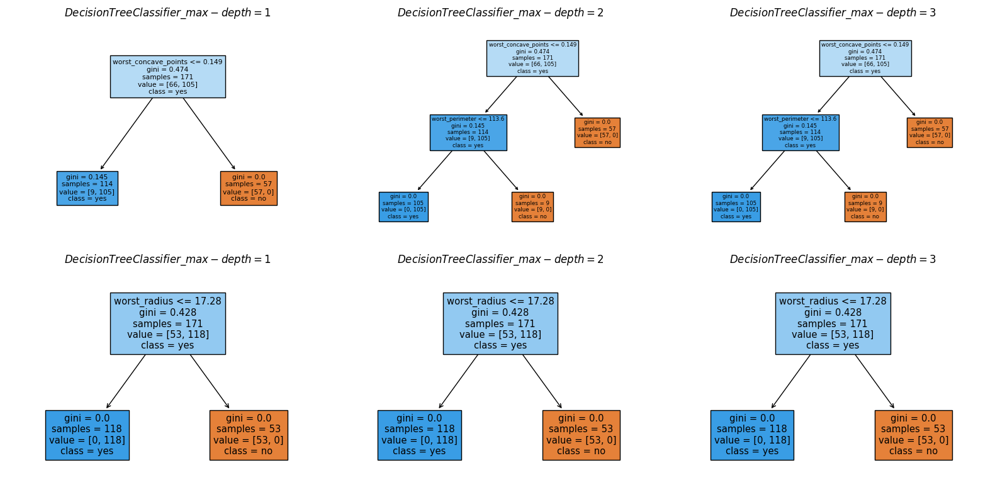

In [138]:
for b_idx, (b_name, b_model) in enumerate(black_box.items()):
    for w_idx, (w_name, w_model) in enumerate(white_box_models.items()):
        plot_tree(
            w_model[b_name],
            feature_names=X.columns,
            class_names=['no', "yes"],
            filled=True,
            ax=axes_tree[b_idx, w_idx]
        )
        axes_tree[b_idx, w_idx].set_title(f"${_names[w_name]}$")
fig_tree.tight_layout()
fig_tree.savefig(
    path_assets / "atv-03_dt_surrogates.{}".format(ext_type_fig),
    **_fig_params
)
fig_tree

Acima podemos ver os nós das arvores para cada modelo caixa preta, sendo respectivamente o *Random Forest* e o *SVC* respectivamente. É possivel notar para o *SVC*, que a arvore de decisão apresentou um impureza nula, para ambas as classes, para apenas 1 nivel de profundidade, e para o *Random Forest*, bastou apenas 2 níveis.

## 2.3 Superficie de separação

Nesta seção, vamos gerar um conjunto de dados sintetico clássico (*Noisy Circles*), treinar um modelo *black box* e *white box*. Apos o treinamento, vamos gerar um numero maior de instancias apartir de uma uniforme definida entre 0 e 1 para poder comparar a superficie de separação o *surrogate* e o *black box*.

### 2.3.1 Aproximando o *white box*

No experimento abaixo, vamos adicionar mais arvores de decisoes, aumentando o numero de profundidade, com o intuito de simular ainda mais proximo o resultado do modelo caixa preta.

In [139]:
n_samples_train = 5000
n_samples_test = 5000
train_seed = 30
test_seed = 31
_params = {
    "factor": 0.6,
    "noise": 0.05
}

In [140]:
max_depth = 6
white_box = {
    f"dt{i}": DecisionTreeClassifier(max_depth=i, random_state=n_seed) for i in range(1, max_depth + 1)
}

_names = {
    "rf": "RandomForestClassifier",
    "dt": "DecisionTreeClassifier",
    "svc": "SVC"
}
_names.update(
    {f"dt{i}": fr"DecisionTreeClassifier\_max-depth={i}" for i in range(1, max_depth + 1)}
)

In [141]:
noise_params = {
    "train": {"random_state": train_seed, "n_samples": n_samples_train},
    "test": {"random_state": test_seed, "n_samples": n_samples_test}
}
noise_params["train"].update(_params)
noise_params["test"].update(_params)

In [142]:
train_noisy_circles, train_nc_labels = make_circles(
    **noise_params["train"]
)

test_noisy_circles, test_nc_labels = make_circles(
    **noise_params["test"]
)

In [143]:
##################################################
# Nesse trecho, é treinado os modelos sorragates
##################################################
ms = ModelSurrogates(white_box, black_box)
white_box_models, black_box_models, white_yhat, black_yhat = ms.fit(
    train_noisy_circles,
    train_nc_labels,
    test_noisy_circles
)

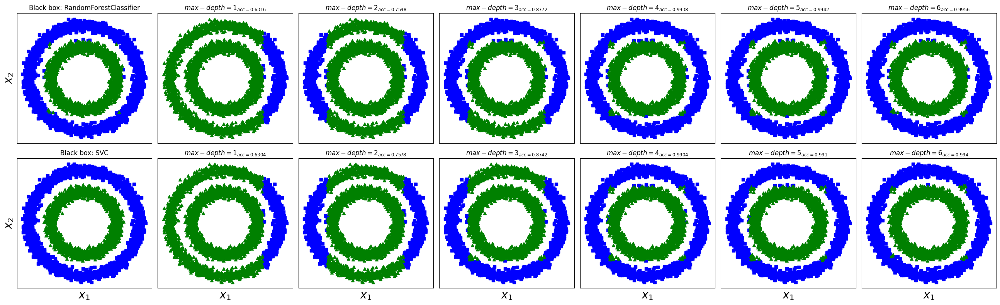

In [144]:
fig_circles, axes_circles = plot_results(
    black_yhat,
    white_yhat,
    test_noisy_circles,
    tick_params,
    _names,
    figsize=(26, 8)
)
fig_circles.tight_layout()
fig_circles.savefig(
    path_assets / "atv-03_circles_dt_surrogates.{}".format(ext_type_fig),
    **_fig_params
)
fig_circles

### 2.3.2 Aumentando o número de dados

In [145]:
n, c = 5000, train_noisy_circles.shape[1]
xy_min = train_noisy_circles.min(axis=0)
xy_max = train_noisy_circles.max(axis=0)

In [146]:
X_simulated = np.random.uniform(
    low=xy_min,
    high=xy_max,
    size=(n, c)
)

### 2.3.3 Predições

In [147]:
bs_yhat = {}
for bs_name, bs_model in black_box_models.items():
    bs_yhat[bs_name] = bs_model.predict(X_simulated)

In [148]:
ws_yhat = {}
for ws_name, ws_model in white_box_models.items():
    ws_yhat[ws_name] = {}
    for bs_name, bs_model in ws_model.items():
        ws_yhat[ws_name][bs_name] = bs_model.predict(X_simulated)

### 2.3.4 Plot

In [149]:
fig, axes = plt.subplots(len(bs_yhat.keys()), len(ws_yhat.keys()) + 1, figsize=(12, 6))
plt.close()

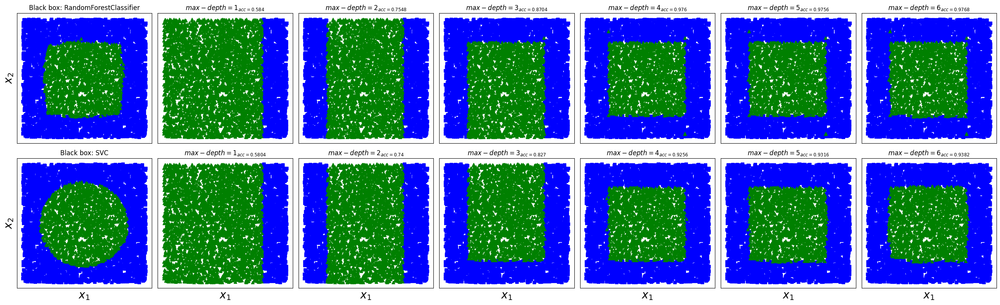

In [150]:
fig_simu, axes_simu = plot_simulation_results(
    bs_yhat,
    ws_yhat,
    X_simulated,
    tick_params,
    _names,
    figsize=(26, 8)
)
fig_simu.tight_layout()
fig_simu.savefig(
    path_assets / "atv-03_uniform_dt_surrogates.{}".format(ext_type_fig),
    **_fig_params
)
fig_simu

Podemos notar que o *Random Forest* sob  o conjunto uniformemente distribuido, identificou um grupo em formato de cubo inscrito dentro do cubo maior e o *SVC* similar, contudo circunscrito no quadrado maior. Ao olhar para os modelos caixa branca, é possivel notar o "trajeto" que o modelo levou para identificar o quadrado interno como o segundo grupo para o Random Forest, e conseguiu se aproximar significantemente do resultado do modelo caixa preta. Já analisando o *SVC*, ele conseguiu identificar o subgrupo mas nao conseguiu definir o formato dele, possivelmente pela diferença entre as naturezas dos algoritmos, aonde o *SVC* busca traçar um hiperplano que consiga dividar as caracteristicas dos grupos diferente da Arvore de decisãp,  que busca subdividar os dados em subconjuntos homogeneos.

## 2.4 Conclusões

Para o problema do breast cancer, foi aplicado dois modelos de caixa preta, *SVC* e o *Random Forest*, e para o modelo caixa branca, foi aplicado variações de profundidade de Arvores de Decisão. Ao decorrer da atividade, é possivel notar o quão interessante é método de *Surrogates*, aonde é possivel reduzir bastante o custo computacional, uma vez que é possivel aproximar modelos caixa preta  por meio de métodos além de ser mais interpretaveis, menos custosos.

Além de ser menos custoso, o método nos proporciona a possibilidade de, por meio de métodos interpretaveis, aproximar como o modelo caixa preta tomou certas decisões para determinada classificação de uma instância. 

Ao olhar a subseção `2.2.1`, é possível notar que apartir de uma profundidade de 2 dois nós, o método caixa branca conseguiu estimar bem o comportamento do modelo caixa preta, considerando as variáveis *worst concave points* e *worst perimeter* mais decisorias e importantes para a separação dos tipos de cancer, respectivamente.

---
# 3. Feature Importances

Durante esta seção  iremos justar um modelo para a base de dados *breast cancer*, avaliar seu desempenho por meio do método de Cross Validation e verificar o *Feature Importance* por classe, utiliznado o método *Permutation Feature Importance*.

## 3.1 Modelagem

### 3.1.1 Fit 

In [151]:
model = RandomForestClassifier(random_state=n_seed_atv4)
model.fit(X_train, y_train)

RandomForestClassifier(random_state=24)

### 3.1.2 Avaliando

In [152]:
full_model_metrics = calculate_metrics(model, X, y, X.columns, which_metrics=which_metrics, cv=cv)
full_model_metrics

Cros-validation: 100%|██████████| 5/5 [00:15<00:00,  3.17s/it]


,Acc,Prec,Rec,F1,AUC
all_features,0.97193,0.9734,0.983175,0.977884,0.968211


## 3.2 Permutation Feature Importance (PFI)

### 3.2.1 Full model

In [153]:
result = permutation_importance(
    model,
    X_test,
    y_test,
    n_repeats=n_repeats,
    random_state=n_seed_pfi
)
sorted_idx = result.importances_mean.argsort()
del result["importances"]
result["features"] = X_test.columns
data_result = pd.DataFrame(result).set_index(["features"]).sort_values("importances_mean")

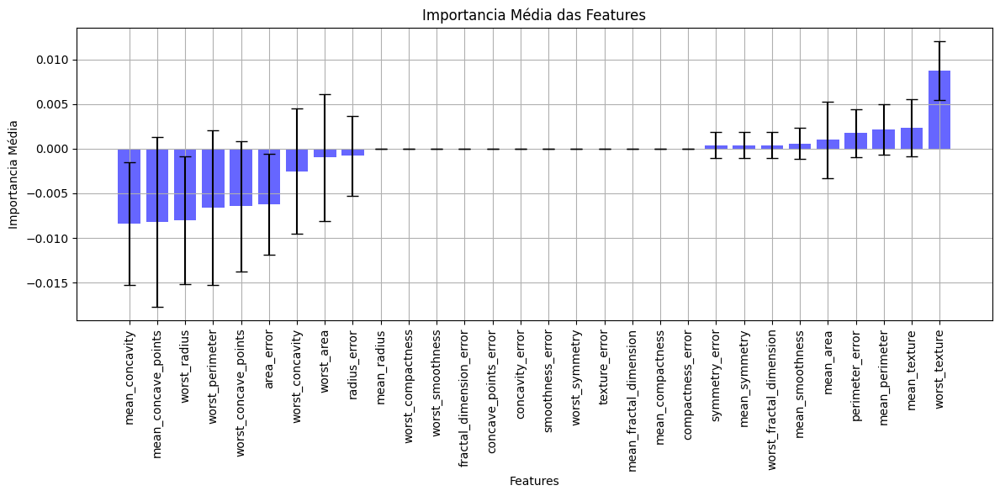

In [154]:
# Plotagem do gráfico de barras
fig_full, axes_full = plt.subplots(1, 1, figsize=(12, 6))
axes_full.bar(
    data_result.index,
    data_result['importances_mean'],
    color='blue',
    alpha=0.6,
    yerr=data_result['importances_std'],
    capsize=5
)
axes_full.set_xlabel('Features')
axes_full.set_ylabel('Importancia Média')
axes_full.set_title('Importancia Média das Features')
axes_full.set_xticklabels(data_result.index, rotation=90)
axes_full.grid()
fig_full.tight_layout()
fig_full.savefig(
    path_assets / "atv-04_feature_importance_full.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

### 3.2.2 Por classe

Abaixo será separado o conjunto de teste pelas classes, para o calculo do *PFI*.

In [155]:
results = {}
for class_label in tqdm(np.unique(y_test)):
    X_test_class = X_test[y_test == class_label]
    y_test_class = y_test[y_test == class_label]

    result = permutation_importance(
        model,
        X_test_class,
        y_test_class,
        n_repeats=n_repeats,
        random_state=n_seed_pfi
    )
    sorted_idx = result.importances_mean.argsort()
    del result["importances"]
    result["features"] = X_test.columns
    result["label"] = [f"class_{class_label}"] * X_test.shape[1]
    results[f"c{class_label}"] = pd.DataFrame(result).set_index(["label", "features"])
data_result_class = pd.concat(list(results.values())).reset_index()

100%|██████████| 2/2 [00:13<00:00,  6.81s/it]


### 3.2.3 Analise


Ao analisar a importância das características no modelo observamos uma variação significativa na *importance* de cada *feature* para o modelo. Considerando primeiramente o modelo completo, notamos que algumas *features* têm uma influência considerável, enquanto outras têm importância praticamente nula. Uma analise interessante seria das *features*  *mean_concavity*, *mean_concave_points* e *worst_radius* que tiveram uma importância negativa, evidenciando que essas features perturbando aleatoriamente as instancias, apresentaram metricas maiores que o modelo completo. Já olhando para a *feature* *worst_texture*, que possui uma importância positiva relativamente alta, indicando uma associação forte para a classificação de uma instância como classe positiva, que seria o cancer benigno.

## 3.3 Gráficos

### 3.3.1 Visualização

In [156]:
num_colors = len(np.unique(y))

In [157]:
color_sequence = generate_color_range(
    lower_color_name,
    upper_color_name,
    num_colors
)

In [158]:
groups = data_result_class.groupby(['features', 'label']).mean().unstack()
ci_mean_importances = groups['importances_mean']['class_0']
ordered_features_full = ci_mean_importances.sort_values().index.tolist()

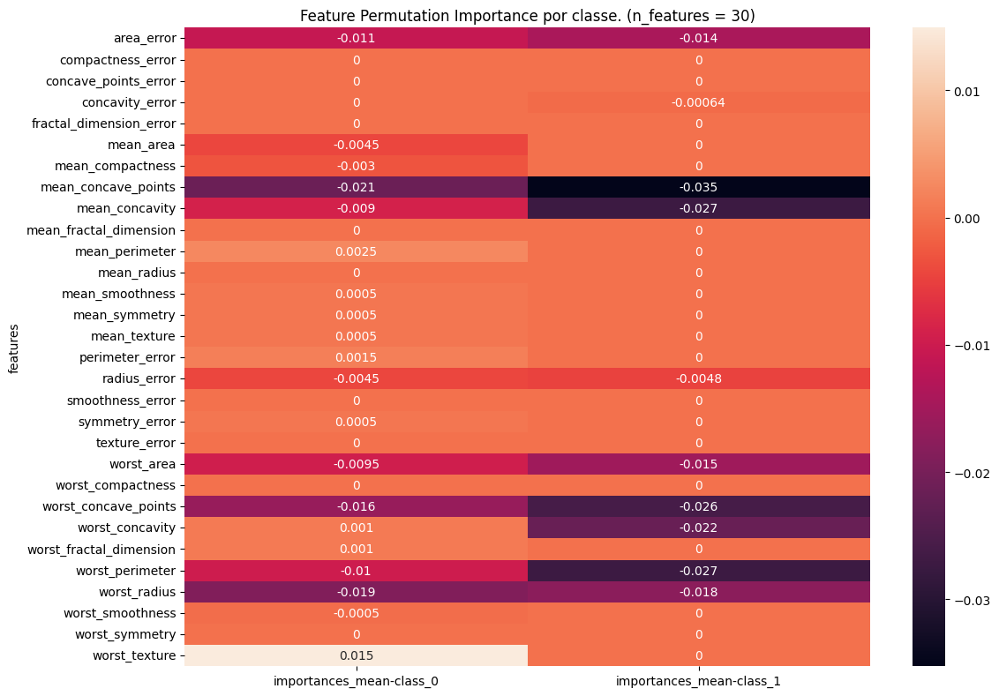

In [159]:
fig_hm, _ = plot_heatmap(
    groups,
    y,
    figsize=(12, 8)
)
fig_hm.tight_layout()
fig_hm.savefig(
    path_assets / "atv-04_hm_pfi.{}".format(ext_type_fig),
    **_fig_params
)
fig_hm

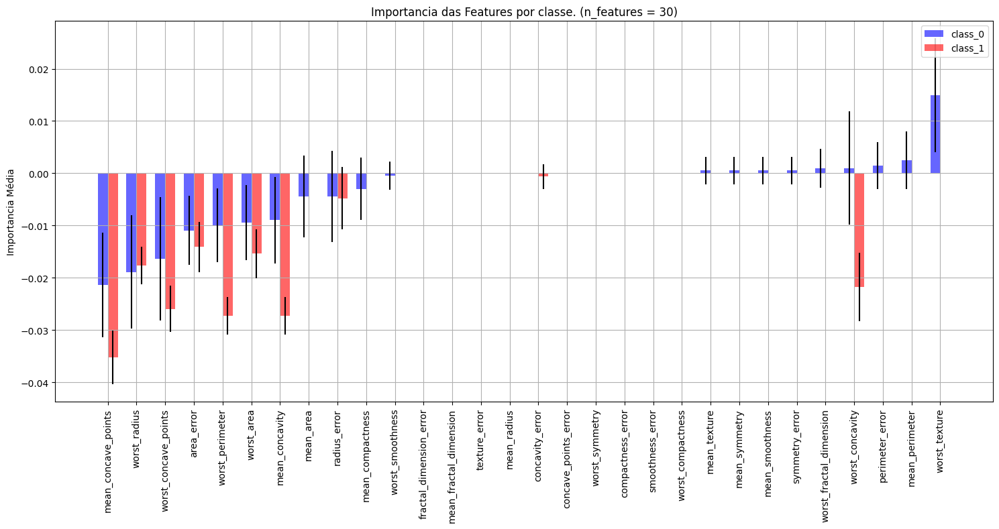

In [160]:
fig_bar, _ = plot_bar_chart(
    groups,
    ordered_features_full,
    color_sequence,
    figsize=(15, 8)
)
fig_bar.tight_layout()
fig_bar.savefig(
    path_assets / "atv-04_bar_pfi_byclass.{}".format(ext_type_fig),
    **_fig_params
)
fig_bar

### 3.3.2 Analise

Algumas *features* apresentaram importância negativa tanto para a classe 1 (câncer benigno) quanto para a classe 0 (câncer maligno). Isso sugere que a essa *features*, ao serem perturbadas aleatoriamente, apresenta-se um aumento da metrica avaliada pelo *PFI*. 

Além disso, outras *features* têm importância negativa mais forte para uma das classes em comparação com a outra. Por exemplo, *mean_concave_points* e *worst_concave_points* têm importância negativa tanto para a classe 0 quanto para a classe 1, mas apresentam valores mais baixos para a classe 1.

Por fim, podemos observar que algumas *features* têm importância positiva para uma das classes, sendo ela a *feature* *worst_texture* tem importância positiva para a classe 0, o que indica que sua presença está associada a um aumento na probabilidade de classificação da classe positiva. No entanto, essa mesma *feature* não tem influência direta na classificação da classe 1.

## 3.4 Selecionado Features com importancia positiva

### 3.4.1 Fit

In [161]:
condition = data_result.importances_mean > 0
features = list(data_result[condition].index)

In [162]:
model = RandomForestClassifier(random_state=n_seed_atv4)
model.fit(X_train[features], y_train)

RandomForestClassifier(random_state=24)

### 3.4.2 Avaliação

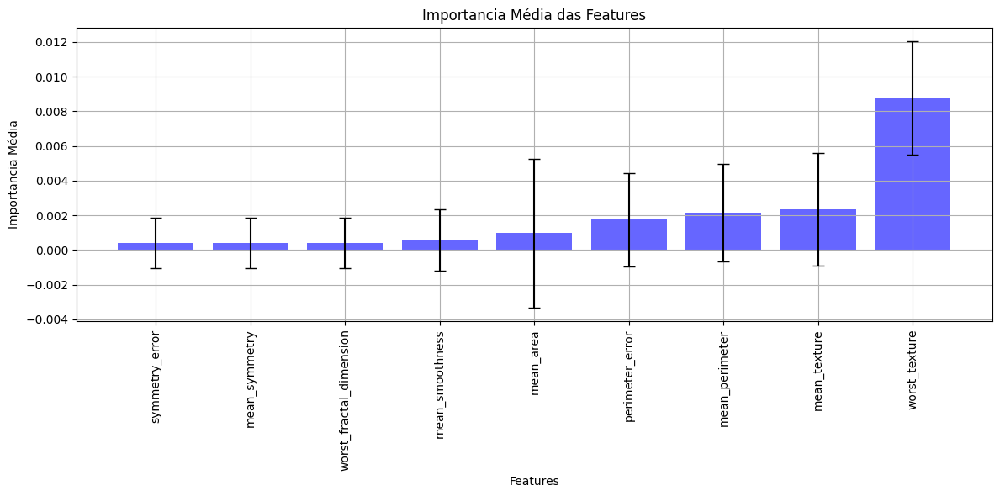

In [163]:
fig_full, axes_full = plt.subplots(1, 1, figsize=(12, 6))
axes_full.bar(
    data_result[condition].index,
    data_result[condition]['importances_mean'],
    color='blue',
    alpha=0.6,
    yerr=data_result[condition]['importances_std'],
    capsize=5
)
axes_full.set_xlabel('Features')
axes_full.set_ylabel('Importancia Média')
axes_full.set_title('Importancia Média das Features')
axes_full.set_xticklabels(data_result[condition].index, rotation=90)
axes_full.grid()
fig_full.tight_layout()
fig_full.savefig(
    path_assets / "atv-05_bar_pfi_selected.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

In [164]:
partial_model_metrics = calculate_metrics(
    model,
    X,
    y,
    features,
    which_metrics=which_metrics,
    cv=cv
)
partial_model_metrics

Cros-validation: 100%|██████████| 5/5 [00:11<00:00,  2.31s/it]


,Acc,Prec,Rec,F1,AUC
partial_features,0.952538,0.956618,0.971984,0.962969,0.946165


In [165]:
results = pd.concat([full_model_metrics, partial_model_metrics]).T

In [166]:
results

,all_features,partial_features
Acc,0.971930,0.952538
Prec,0.973400,0.956618
Rec,0.983175,0.971984
F1,0.977884,0.962969
AUC,0.968211,0.946165


### 3.4.3 Conclusões

|            | **all_features** | **partial_features** |
|------------|--------------|------------------|
| **accuracy**   |   0.971930   |      0.952538    |
| **precision**  |   0.973400   |      0.956618    |
| **recall**     |   0.983175   |      0.971984    |
| **f1**         |   0.977884   |      0.962969    |
| **roc_auc**    |   0.968211   |      0.946165    |


Após analisar os resultados das validações cruzadas para o modelo utilizando todas as variáveis (*full_features*) em comparação com o modelo utilizando apenas as **features** estritamente maior que zero (*partial_features*), podemos observar que ambos os modelos apresentam desempenho bastante semelhante em termos de métricas de avaliação, como *accuracy*, *precision*, *recall*, *f1* e *roc_auc*.

Isso sugere uma notável robustez do modelo, mesmo após a retirada das *features* que têm importância menor ou igual a zero, considerando o modelo geral. O modelo com menos variáveis, que utiliza apenas as que posssuem relevância para a classificação, segundo o *PFI*, mantém um desempenho praticamente igual ao modelo completo. Essa consistência no desempenho indica que as *features* removidas não contribuem significativamente para a capacidade do modelo de fazer previsões precisas.

Portanto, a capacidade do modelo de manter um desempenho elevado mesmo após a remoção dessas *features* ressalta sua robustez e capacidade de generalização. Essa característica é crucial em situações onde a simplificação do modelo pode ser desejável, seja para reduzir a complexidade, melhorar a interpretabilidade ou aumentar a eficiência computacional, sem comprometer sua precisão.

Além disso, apesar do modelo ainda manter uma boa performance apos a retirada das variáveis, ainda houve uma queda das metricas, isso evidencia também que existia alguma relação intrisica das variaveis que foram retiradas para com o target, havendo alguma importância que o método *Permutation Feature Importance* conseguiu mensurar na sua forma de estimação.

---
# 4. Partial Dependence Plots (PDPs) e Individual Conditional Expectation(ICEs)

Será realizado um *Feature Selection* utilizando o *Permutation Feature Importance*, bem como feito na atividade `04`. As *features* selecionadas serão as que apresentam valor **extritamente maior que zero**, levando em consideração que o método avalia utilizando uma métrica a importancia de uma feature, a medida que os valores dela são perturbados aleatoriamente, e então re-avaliada. Apos isso, é avaliado a diferença entre a métrica selecionada do modelo global menos a métrica avaliada sob a base com a *feature* aleatorizada.

Sob essas features selecionadas, será feito uma analise mais detalhada da distribuição das instâncias por meio do *Boxplot*. Por fim, será calculado a matriz de correlação entre as variáveis e então para fins de visualização, será realizado um conjunto de PDPs e ICEs para variáveis e pares de variáveis não correlacionadas.

## 4.1 Analise da distribuicao das variaveis

In [167]:
X_test_feats = X[features].copy()

### 4.1.1 Boxplot

<Axes: >

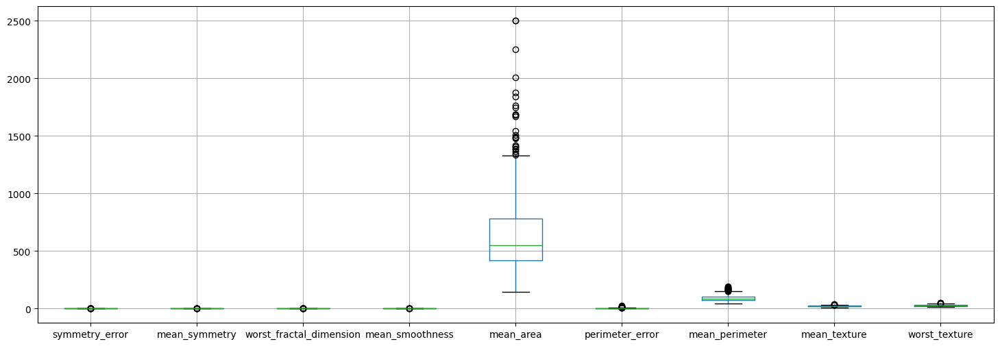

In [168]:
X_test_feats.boxplot(figsize=(18, 6))

É possivel notar que existem variaveis em escalas distintas, dificultando a visualização dos boxplots para analise da distribuicao por variavel. Vamos aplicar uma normalizacao das variaveis para tentar visualizar em conjunto.

In [169]:
X_std = X_test_feats.copy()
for col in X_std.columns:
    X_std[col] = (X_std[col] - X_std[col].mean()) / X_std[col].std()

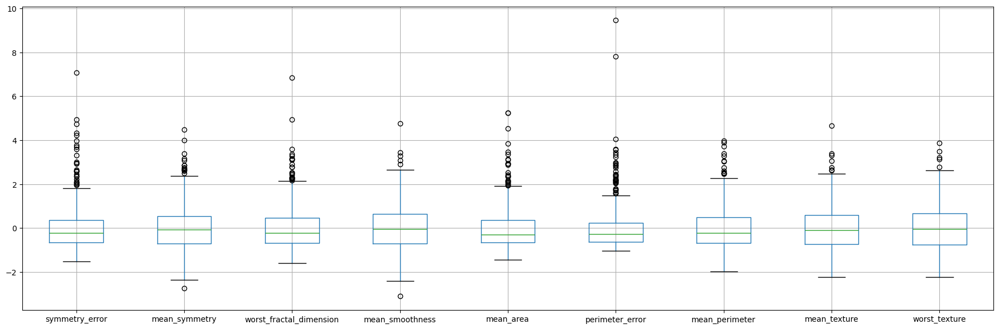

In [170]:
axes_std = X_std.boxplot(figsize=(18, 6))
fig_std = axes_std.get_figure()
fig_std.tight_layout()
fig_std.savefig(
    path_assets / "atv-05-boxplot_std.{}".format(ext_type_fig),
    **_fig_params
)

Podemos notar que existem todas as variaveis aparentam ter uma distribuição com muitas instâncias outliers superiormente, em especial a mean_area e perimeter_error, apresentando uma baixa variabilidade, com presença de outliers superiores.

### 4.1.2 Heatmap das correlacoes

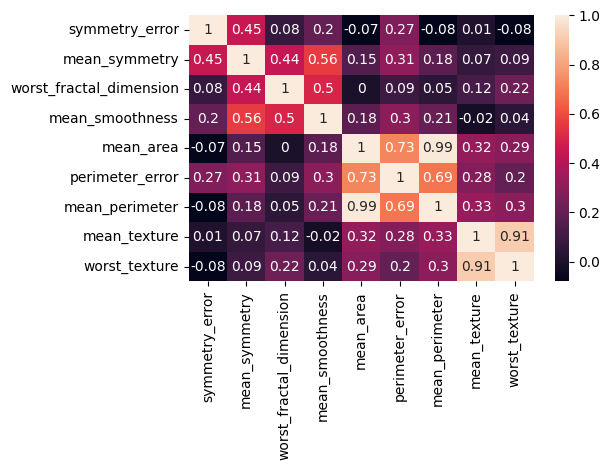

In [171]:
axes_hm = sns.heatmap(X_test_feats.corr().round(2), annot=True)
fig_hm = axes_hm.get_figure()
fig_hm.tight_layout()
fig_hm.savefig(
    path_assets / "atv-05-hm_corr.{}".format(ext_type_fig),
    **_fig_params
)

Acima podemos ver que as variaveis apresentam uma baixa correlação em geral entre elas, com excessão de variaveis que são calculadas em cima da featire respectiva, como a mean_area, perimeter_error e mean_perimeter, alem disso mean_texture com worst_texture.

Essas baixas correlações podem dar mais veracidade aos gráficos *Partial Dependence Plot* (PDPs) e *Individual Conditional Expectation* (ICE).

## 4.2 Partial Dependence Plot (PDPs)

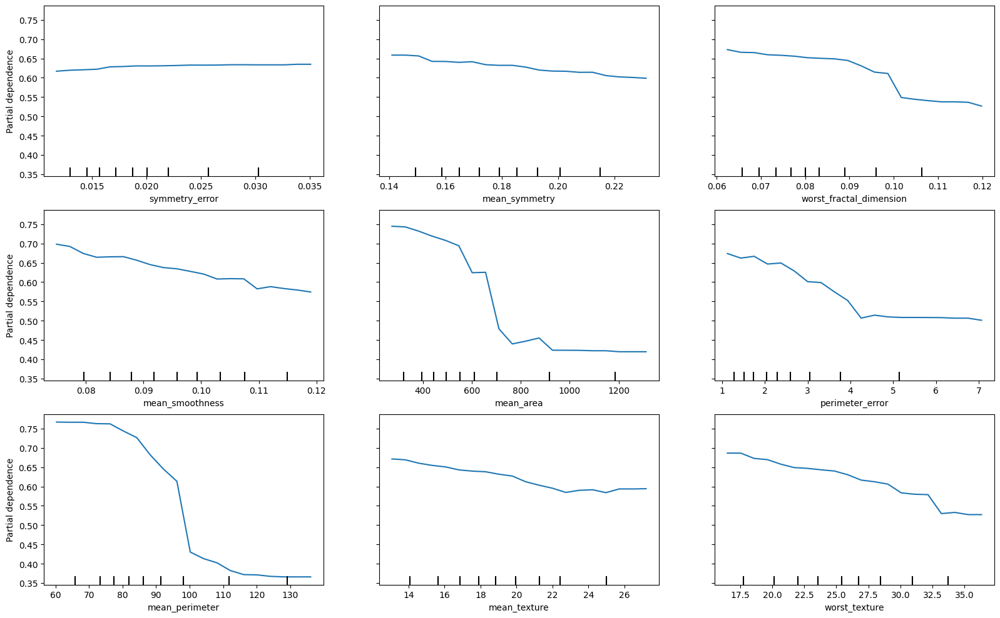

In [172]:
fig_pdp_m1, axes_pdp_m1 = plt.subplots(1, 1, figsize=(16, 10))
disp1 = PartialDependenceDisplay.from_estimator(
    model,
    X_test_feats,
    features,
    grid_resolution=20,
    ax=axes_pdp_m1
)
fig_pdp_m1.tight_layout()
fig_pdp_m1.savefig(
    path_assets / "atv-05-pdp_byfeature.{}".format(ext_type_fig),
    **_fig_params
)

Algumas informações interessantes podem ser obtidas dos graficos acima.

1. As variáveis simmetry_error e mean_symmetry  não aprensenta muita mudança na probabilidade do cancer do individuo ser benigno.

2. Quase todas (com excessão do symmetry_error), mesmo que pequeno, possui um declinio na probabilidade do cancer ser benigno.

3. As proporção de pontos sob o suporte de cada variavel parece bastante balanciada, com excessão do perimeter_error e mean_area.

4. As variaveis worst_texture, mean_perimeter, perimeter_error, mean_area e worst_fractal_dimension apresentam comportamentos interessantes, com quedas acentuadas apartir de um ponto de corte no seu respectivo suporte.
 
    4.1. **worst_texture**: existe uma queda das probabilidade no intervalo de 31 a 34, aproximadamente, e apartir ali em diante as probabilidades de ser benigno fica constantes indicando.

    4.2. **mean_perimeter**: é nitido uma queda bem acentuada da probabilidade do cancer ser benigno, evidenciando que tumores com, em média, um perimetro menor apresenta menores chances de ser benigno.

    4.3. **perimeter_error**: bem como o mean_perimeter, existe uma queda continua ate proximo de um valor de 4, e apartir desse ponto as probabilidades ficam constantes, isso pode se dar por conta da proporcao de instâncias centradas em valores inferiores a 4.

    4.4. **mean_area**: assim ocmo o mean_perimeter, tambem é notavel uma queda acentuada das probabilidades de ser benigno, mas tambem podendo ser ocasionada pela forte presenca de instancias no intervalor inferior a 800.

    4.5. **worst_fractal_dimension**: possui um comportamento analago aos outros, mas com um declineo mais lento, contudo um declive maior proximo do valor de 0.1, e então ficando mais constant. Isso pode ser justificado pela baixa presenca de instancias maiores que 0.1.

In [173]:
selected_features = ["mean_smoothness", "mean_perimeter", "worst_texture", "worst_fractal_dimension", "mean_symmetry"]
X_feats_corr = X_test_feats[selected_features].corr()
X_feats_corr

,mean_smoothness,mean_perimeter,worst_texture,worst_fractal_dimension,mean_symmetry
mean_smoothness,1.000000,0.207278,0.036072,0.499316,0.557775
mean_perimeter,0.207278,1.000000,0.303038,0.051019,0.183027
worst_texture,0.036072,0.303038,1.000000,0.219122,0.090651
worst_fractal_dimension,0.499316,0.051019,0.219122,1.000000,0.438413
mean_symmetry,0.557775,0.183027,0.090651,0.438413,1.000000


Vamos utilizar as variaveis acima para gerar os graficos de PDPs em $\mathbb{R}^{2}$, respeitando a questão da não correlação entre as features, uma vez que isso pode impactar diretamente em analises das regiões de decisão dos PDPs.

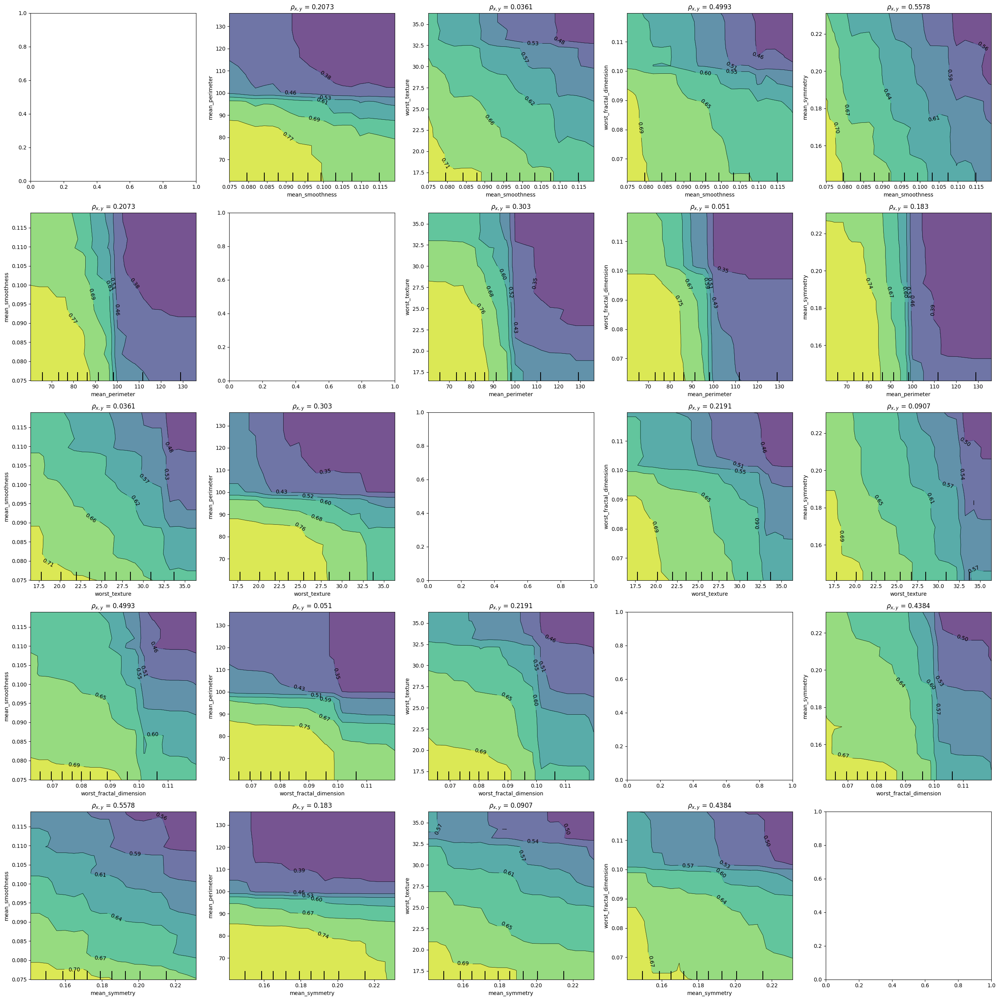

In [174]:
fig_pdp_m1, axes_pdp_m1 = create_pdp_subplots(selected_features, model, X_test_feats)
fig_pdp_m1.tight_layout()
fig_pdp_m1.savefig(
    path_assets / "atv-05-pdp_pairwise.{}".format(ext_type_fig),
    **_fig_params
)

Ao olharmos o gráfico PDP acima, podemos notar ja que a relação entre o mean_symmetry e mean_perimeter, o valor do mean_erimeter independe do valor do mean_symmetry em geral, para definir se é maior ou menor a chance do cancer ser benigno, com excessão de valores maiores do mean_symmetry e menores do mean_perimeter, apresentando uma reducao da probabilidade do cancer ser benigno. Cenário um pouco similar para a relação entre mean_simmetry e worst_fractal_dimension, contudo da para notar que valores menores de ambas as variaveis, uma maior chance do tumor ser benigno, e o inverso é valido também, valores maiores de ambas reduzem a probabilidade do cancer ser benigno.


Alguns pares de variaveis acima, possuem um relacionamento importante, delas podemos listar:

1. **mean_smoothness x mean_symmetry**: aonde parece estar bem definido, para valores de mean_smoothness inferiores a 0.08 e menores que 0.19 aproximadamente, as chances sao maiores do cancer ser benigno, e quando aumentamos ambas as features, reduzimos as probabilidades.
2. **mean_smoothness x worst_texture**: cenário similar ao cenário *(1)* citado acima.
3. **worst_fractal_dimension x worst_texture**: temos uma fronteira de decisão ali perto de 0.1 para o worst_fractal_dimension e 30 para o worst_texture, aonde quanto maior para ambos, existe uma redução das probabilidades de ser benigno, contudo isso pode ser justificado pela baixa presenca de instancias com valores maiores em x; além disso, valores menores de ambos indicam um aumento da chance do tumor ser benigno.

## 4.3. Individual Conditional Expectation (ICE)

Abaixo vamos gerar algumas ICEs.

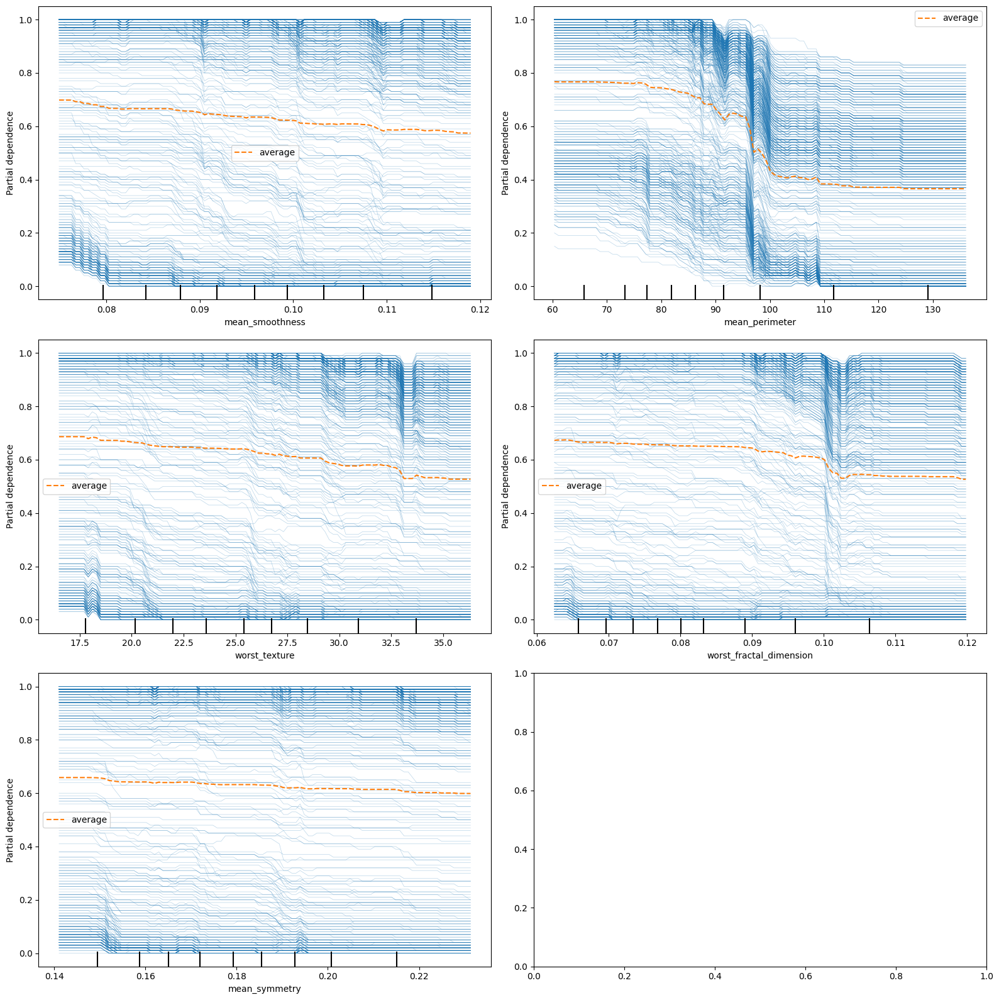

In [175]:
n_cols = 2
n_rows = 3
fig_ice, axes_ice = plt.subplots(n_rows, n_cols, figsize=(16, 16))
axes_ice = axes_ice.flatten()
for i, ax in zip(selected_features, axes_ice):
    disp1 = PartialDependenceDisplay.from_estimator(model, X_test_feats, [i], kind='both', ax=ax)
fig_ice.tight_layout()

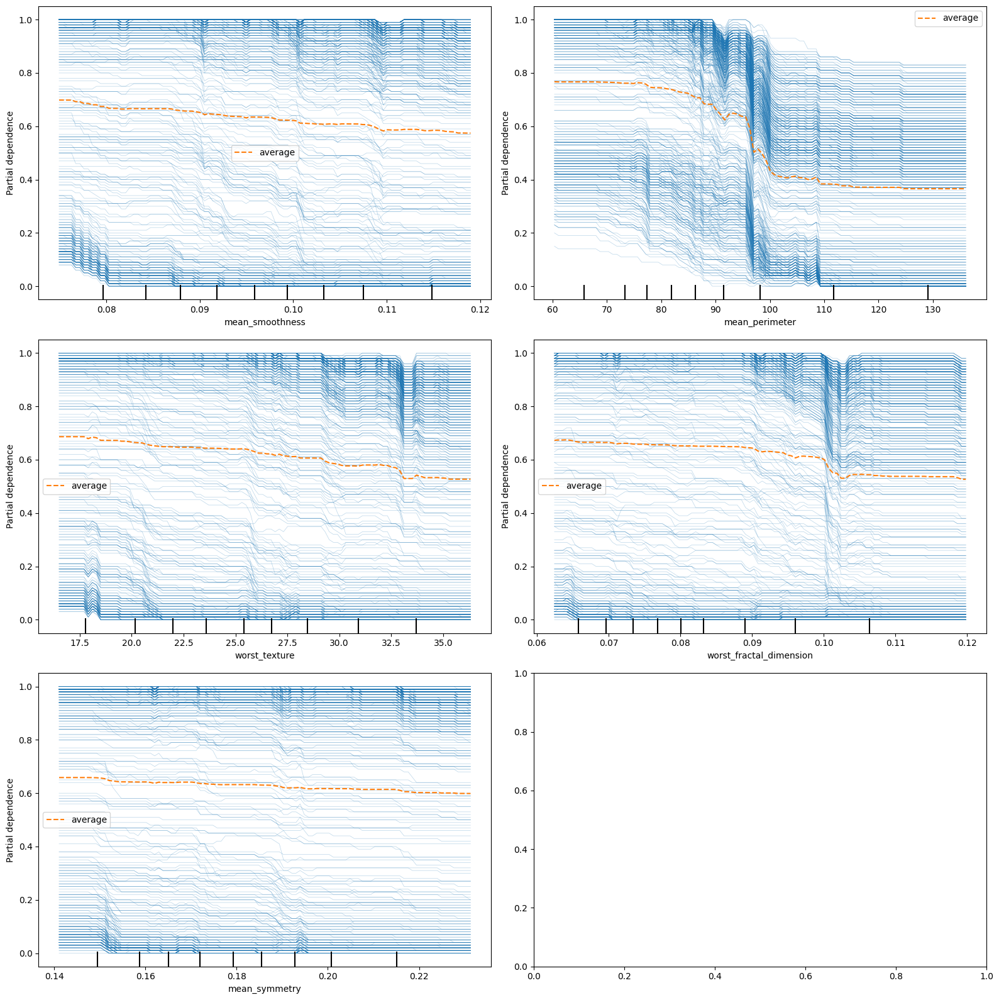

In [176]:
fig_ice.savefig(
    path_assets / "atv-05-ices.{}".format(ext_type_fig),
    **_fig_params
)
fig_ice

Focando apenas na variável mean_perimeter, podemos notar que o risco do cancer ser benigno reduz apartir de 75 de perimetro medio, com uma queda bem brusca dos valores. Além disso, podemos notar que apartir do ponto de corte de 100-110, o risco tende a ser constante, mas também podendo ser justificado pela baixa presença de instancias com valores maiores que esse.

## 4.4 Conclusão

Por fim, podemos notar apartir das métricas que o modelo mantem a robustes, com metricas proximas do modelo completo com todas as features, mesmo apos a seleção de features extritamente positivas. Apos isso, olhando para os PDPs, podemos notar a partial dependence entre pares de features não correlacionadas, tendo algumas com uma fronteira de decisão bem definida entre os tipos de canceres, isso é bastante significante para retirada de insights sobre como o modelo tomou certas decisões ao classificar as instâncias.

Para validação localmente, podemos ter o ICE de cada instância, validando as informações do PDP, aparentemente as instâncias seguem o mesmo comportamento em geral, com respeito a partial dependence.

---
# 5. Local Interpretable Model-Agnostic Explanations (LIME)

Nesta seção, vamos aplicar o LIME para gerar explicações locais para determinadas instâncias, considerando o modelo selecionado apartir das seções anteriores, e com as features selecionadas com feature importance positiva, considerando o método PFI.

## 5.1 Selecionando instâncias

Nessa seção, o intuito será pegar as instâncias mais importantes para ambas as classes, com o intuito de definir os individuos mais representativos daquele grupo, e que maximizem a probabilidade de classe.

Mais a frente, também será selecionado instâncias ja apresentam probabilidades inferiores de pertencimento a determinada classe.

### 5.1.1 Aplicando PCA

Abaixo será aplicado um PCA para conseguir visualizar as instâncias em $\mathbb{R}^{2}$.

In [177]:
pca = PCA(2)
X_std = pca.fit_transform(X_train[features])

### 5.1.2 Selecionando as instancias mais representativas por classe

Será selecionado instancias mais representativas por grupo, baseando-se  na media das features, e então aplicando o PCA para a visualização em $\mathbb{R}^{2}$.

In [178]:
X_centers = {
    "c0": X_train[y_train == 0][features].mean(axis=0).to_frame().T,
    "c1": X_train[y_train != 0][features].mean(axis=0).to_frame().T
}

In [179]:
X_c0_center = pca.transform(X_centers["c0"])
X_c1_center = pca.transform(X_centers["c1"])

### 5.1.3 Visualizando

In [180]:
x_values = np.linspace(X_std[:, 0].min(), X_std[:, 0].max(), 39)
y_values = np.linspace(X_std[:, 1].min(), X_std[:, 1].max(), 39)
x_grid, y_grid = np.meshgrid(x_values, y_values)

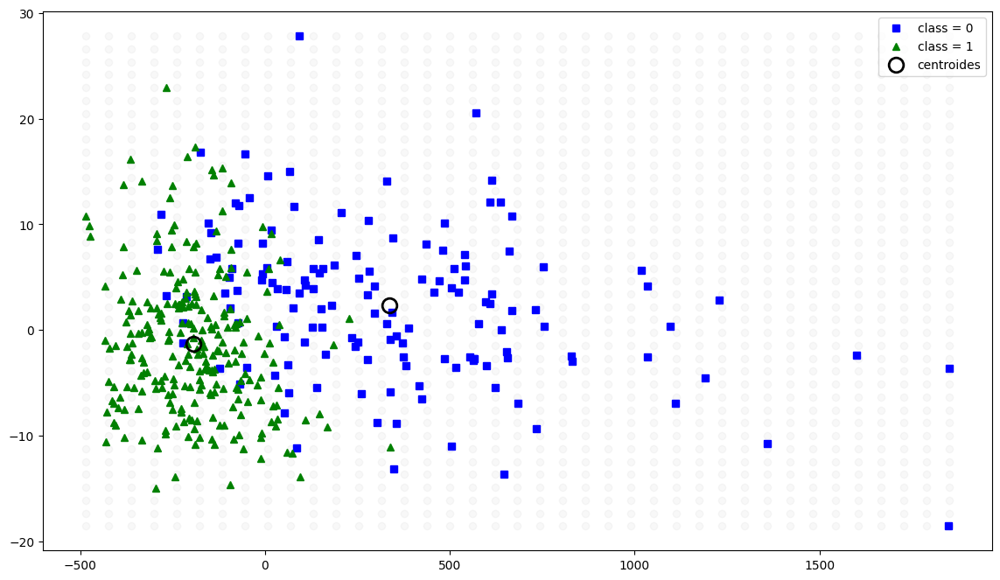

In [181]:
fig_i, axes = plt.subplots(1, 1, figsize=(14, 8))
axes.scatter(
    x_grid,
    y_grid,
    c='grey', alpha=0.05
)
axes.plot(
    X_std[y_train == 0, 0],
    X_std[y_train == 0, 1],
    "bs",
    label="class = 0"
)
axes.plot(
    X_std[y_train != 0, 0],
    X_std[y_train != 0, 1],
    "g^",
    label="class = 1"
)
axes.plot(
    np.array([X_c0_center[:, 0], X_c1_center[:, 0]]),
    np.array([X_c0_center[:, 1], X_c1_center[:, 1]]),
    "ko",
    markersize=12,
    markerfacecolor='none',
    markeredgewidth=2,
    label="centroides"
)
axes.legend()
fig_i.savefig(
    path_assets / "atv-06-scatter_centers.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

### 5.1.4 Utilizando as probabilidades de pertencimento a classe positiva

Vamos tentar ilustrar um pouco melhor o gráfico acima, utilizando a classe positiva como referência, adicionado a probabilidade de pertencimento a classe positiva como informação ao gráfico

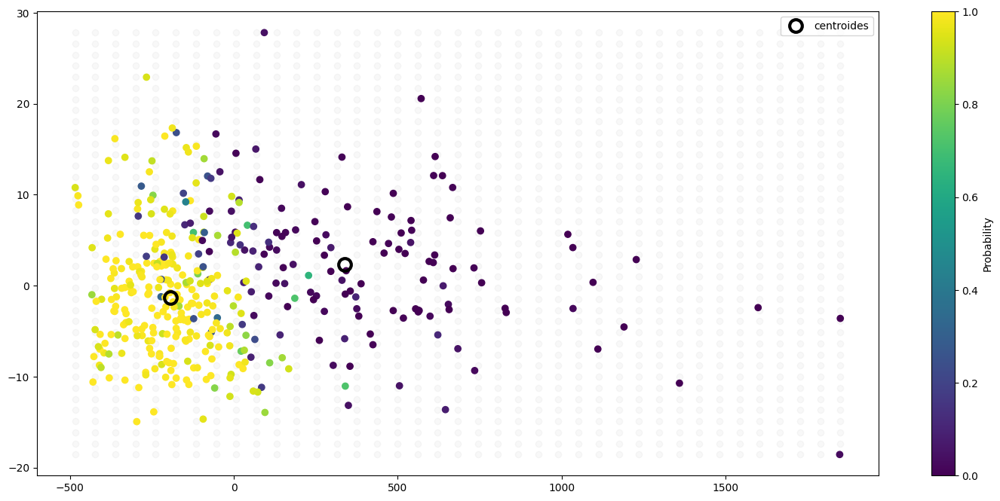

In [182]:
fig_probs, axes_probs = plt.subplots(1, 1, figsize=(18, 8))
axes_probs.scatter(
    x_grid,
    y_grid,
    c='grey', alpha=0.05
)
scatter = axes_probs.scatter(
    X_std[:, 0],
    X_std[:, 1],
    c=model.predict_proba(X_train[features])[:, 1],
    cmap='viridis'
)
axes_probs.plot(
    np.array([X_c0_center[:, 0], X_c1_center[:, 0]]),
    np.array([X_c0_center[:, 1], X_c1_center[:, 1]]),
    "ko",
    markersize=12,
    markerfacecolor='none',
    markeredgewidth=3,
    label="centroides"
)
fig_probs.colorbar(scatter, ax=axes_probs, label='Probability')
axes_probs.legend()
fig_i.savefig(
    path_assets / "atv-06-scatter_centers.{}".format(ext_type_fig),
    **_fig_params
)
fig_i.savefig(
    path_assets / "atv-06-probs_scatter_centers.{}".format(ext_type_fig),
    **_fig_params
)
plt.show()

### 5.1.5 Selecionando mais algumas instâncias

Nesta seção, vamos selecionar duas instâncias a mais para analise sob o *Local Interpretable Model-Agnostic Explanations* (LIME), sendo eles seguindo as seguintes caracteristicas:

1. Instância distante do grupo da classe postiva;

2. Instância no exato ponto médio entre os centroides;

3. Instância em local com mais sobreposicao de classes.

Para o ponto (1.), vamos selecionar a instancia mais distante de ambos os grupos.

Já para o ponto (2.), vamos calcular o ponto médio entre os centroides de cada grupo.

exemplo:
$$
x_{pm} = \frac{x^{(0)}_{pm} + x^{(1)}_{pm}}{2}
$$

e

$$
y_{pm} = \frac{y^{(0)}_{pm} + y^{(1)}_{pm}}{2}
$$

Para o ponto (3.), sera selecionado manualmente a instância.

In [183]:
x_feats_1 = X_train.iloc[np.where((X_std[:, 0] > 1700) & (X_std[:, 1] > -5))[0], :][features].copy()
y_true_1 = y_train[np.where((X_std[:, 0] > 1700) & (X_std[:, 1] > -5))[0]][0]
x1 = pca.transform(x_feats_1)[0]

In [184]:
x_pm = (X_centers["c0"] + X_centers["c1"]) / 2
x2 = pca.transform(x_pm)[0]

In [185]:
x_feats_2 = X_train.iloc[
    np.where((X_std[:, 0] == -91.9109803837386) & (X_std[:, 1] == 5.880924007768748))[0], :
][features].copy()
y_true_2 = y_train[np.where((X_std[:, 0] == -91.9109803837386) & (X_std[:, 1] == 5.880924007768748))[0]][0]
x3 = pca.transform(x_feats_2)[0]

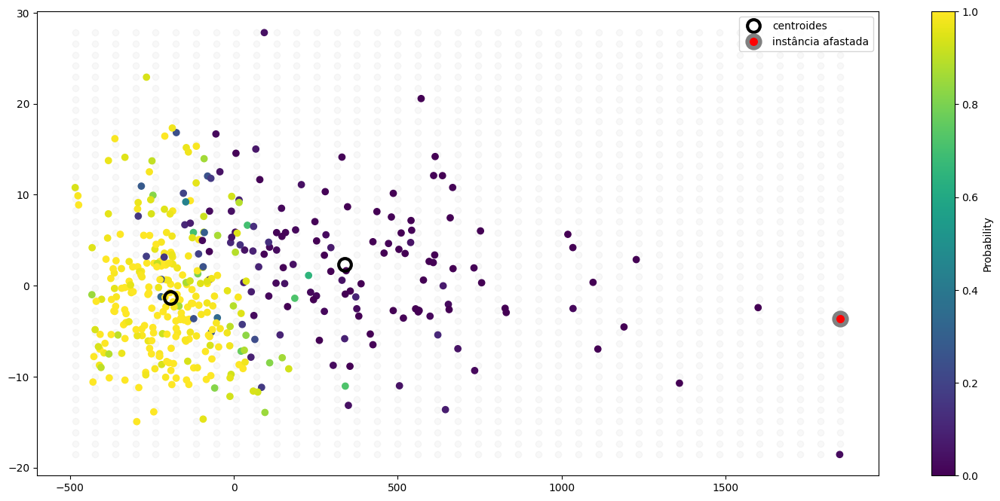

In [186]:
axes_probs.plot(
    x1[0],
    x1[1],
    "ko",
    markersize=12,
    markerfacecolor='red',
    markeredgewidth=4,
    markeredgecolor='gray',
    label="instância afastada"
)
axes_probs.legend()
fig_probs

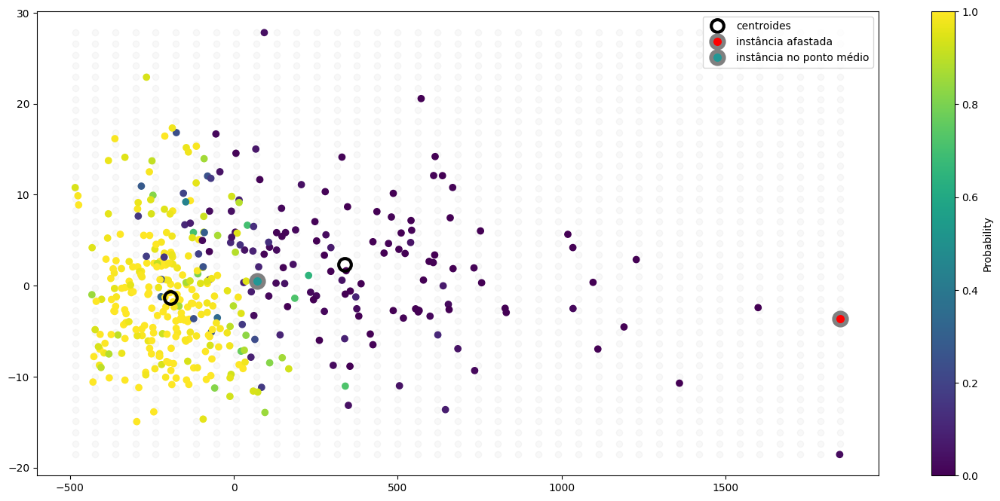

In [187]:
axes_probs.plot(
    x2[0],
    x2[1],
    "ko",
    markersize=12,
    markerfacecolor='#219795',
    markeredgewidth=4,
    markeredgecolor='gray',
    label="instância no ponto médio"
)
axes_probs.legend()
fig_probs

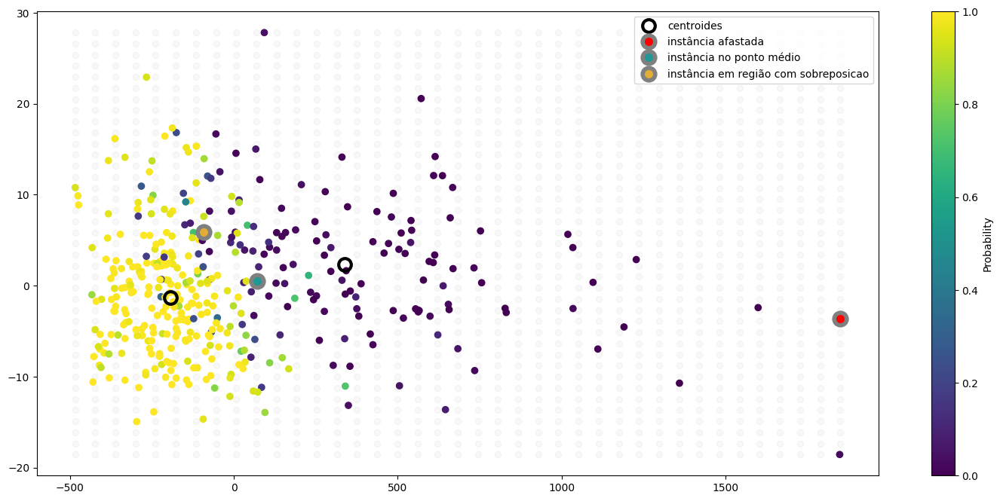

In [188]:
axes_probs.plot(
    x3[0],
    x3[1],
    "ko",
    markersize=12,
    markerfacecolor='#e2ad32',
    markeredgewidth=4,
    markeredgecolor='gray',
    label="instância em região com sobreposicao"
)
axes_probs.legend()
fig_probs.savefig(
    path_assets / "atv-06-probs_scatter_instances.{}".format(ext_type_fig),
    **_fig_params
)
fig_probs

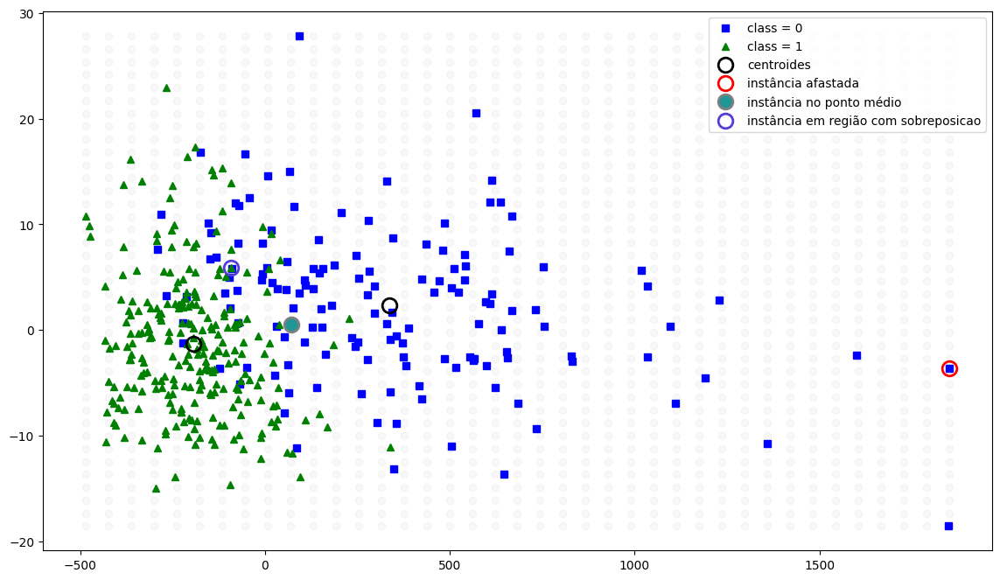

In [189]:
axes.plot(
    x1[0],
    x1[1],
    "ko",
    markersize=12,
    markerfacecolor='none',
    markeredgewidth=2,
    markeredgecolor='red',
    label="instância afastada"
)
axes.plot(
    x2[0],
    x2[1],
    "ko",
    markersize=12,
    markerfacecolor='#219795',
    markeredgewidth=2,
    markeredgecolor='gray',
    label="instância no ponto médio"
)
axes.plot(
    x3[0],
    x3[1],
    "ko",
    markersize=12,
    markerfacecolor='none',
    markeredgewidth=2,
    markeredgecolor='#553bd8',
    label="instância em região com sobreposicao"
)
axes.legend()
fig_i.savefig(
    path_assets / "atv-06-scatter_centers_instances.{}".format(ext_type_fig),
    **_fig_params
)
fig_i

|                        |     **$pca_{X_1}$**    |     **$pca_{X_2}$**    |     **true label**    |   
|------------------------|-----------|-----------|-----------|
| **instância afastada**    | 1850.4459 | -3.592414 | 0 |
| **instância no ponto médio**|  71.951322|  0.495681 | - |
| **instância em região com sobreposição**|  -91.91098038|  5.88092401 | 1 | 
| **centroide classe negativa**| 337.105269| 2.322356  | - |
| **centroide classe positiva**| -193.202625| -1.330995 | - |

## 5.2 LIME

Nesta seção, vamos aplicar o LIME sob as instâncias selecionadaras anteriormente, listadas na tabela acima.

### 5.2.1 Fit a classe criada para o LIME

In [190]:
le = LimeExplainer(X_train, list(features), model)
le.fit(
    mode='classification',
    features=features,
    class_names=np.unique(y_train),
    random_state=n_seed
)

### 5.2.2 Explain Instance: para cada uma das situações da seção anterior

#### 5.2.2.1 Centroide da classe negativa

In [191]:
le.explain_instance(X_centers["c0"], show=True)  # centroide classe 0

Nesse cenário, o intuito é mostrar quais são as variáveis mais importante para a instância que, em termos da média, melhor representa o grupo da classe 0. Dessa forma, podemos notar que a probabilidade de pertencimento a esse grupo para essa isntância é 1,  mostrando que valores de variaveis como perimeter_error > 3.33 ou mean_area > 776.17 para uma instância foram bem impactantes para essa instância localmente.

#### 5.2.2.2 Centroide da classe positiva

In [192]:
le.explain_instance(X_centers["c1"], show=True)  # centroide classe 1

Diferente da situação da seção (5.2.2.1), essa isntância que, em termos da média, melhor representa o grupo positivo, podemos notar que para as mesmas variáveis perimeter_error e mean_area, possuem valores bem  diferente, aonde temos perimeter_error < 1.6, mean_area > 418.98 e mean_perimeter < 75.04, mostrando que para a classificação dessa instância em especifico essas featuresd foram mais importantes.

#### 5.2.2.3 Instância mais distante do grupo positivo

In [193]:
print("True label: [{}]".format(y_true_1))
le.explain_instance(x_feats_1, show=True)  # instancia mais distante do grupo 01

True label: [0]


Nesse cenário, temos uma situação similar a seção (5.2.2.1), aonde as mesmas variáveis tiveram maior importancia para a classificação. Como podemos ver, o modelo classificou corretamente essa instância, então a decisão correta foi tomada.

#### 5.2.2.4 Instância no ponto médio entre os centroides

In [194]:
le.explain_instance(x_pm, show=True)  # instancia no ponto medio entre os centroides

Nitidamente podemos notar que o modelo ja apresentou um grau de incerteza maior ao classificar essa instância, apresentando valores de features que se enquadram melhor na classe postiva, contudo predominou a classe negativa, então o ponto médio seria considerado, majoritariamente como da classe 0, segundo o modelo.

#### 5.2.2.5 Instância em região com overlapping

In [195]:
print("True label: [{}]".format(y_true_2))
le.explain_instance(x_feats_2, show=True)  # instância em região com overlapping

True label: [1]


Apesar de haver uma alta incerteza na hora do modelo tomar a decisão, devido a valores de features tambem que se enquadram na classe negativa,o modelo classificou corretamente a instância, apesar  do overllapping, e com uma probabilidade de classe alta, evidenciando uma certa robustez para tratar com casos de overlapping, considerando esse modelo sob o conjunto de dados breast_cancer.

#### 5.2.2.6 Overall

In [196]:
le.explain_instance(X_centers["c0"], show=True)  # centroide classe negativa
le.explain_instance(X_centers["c1"], show=True)  # centroide classe positiva
le.explain_instance(x_feats_1, show=True)  # instancia mais distante do grupo positiva
le.explain_instance(x_pm, show=True)  # instancia no ponto medio entre os centroides
le.explain_instance(x_feats_2, show=True)  # instância em região com overlapping

Acima, podemos notar que as instancias relacionadas aos ponto medio entre os centroides e a instancia com overlapping, apesar de apresentarem probabilidades de classe altas, os valores das feature importance sao aparentam ter nenhuma variavel significante para a classificacao, evidenciando que o modelo apresentou uma alta incerteza na decisão sobre esses pontos.

### 5.2.3 Conclusão

O LIME é uma métrica muito boa para avaliação pontualmente de instâncias, aonde é possivel ter uma analise  similar a uma arvore de decisão, podendo evidenciar pontos de cortes para aquela previsão.  O LIME aparenta ser bem interessante quando visamos utilizar métodos mais "agradaveis" para visualizar uma importancia de determinadas previsões, tanto para alguem leigo quanto alguem por dentro da área.

Além de ser uma técnica eficiente, ela consegue auxiliar diretamente na tarefa de prevenção, evidenciando que features estão intrisicamente com a classe positiva ou negativa, um exemplo de cenário disso seria o cenário do conjunto de dados abordado, *breast cancer*.

---
# 6. Conclusões

Com base na análise realizada neste trabalho, podemos concluir que a interpretabilidade dos modelos preditivos é crucial para compreender o comportamento e a lógica das suas decições. Foi aplicado uma seleção de modelos utilizando de métodos de validação cruzada, para a escolha do melhor modelo, também aplicando métodos como surrogates, feature importances, partial dependence plots, individual conditional expectation e local interpretable model-agnostic explanations (LIME), pudemos obter insights valiosos sobre como esses modelos estão tomando suas decisões.

Através dessas análises, foi possível identificar quais variáveis são mais relevantes para o modelo obtido apartir da validação cruzada, como elas impactam as previsões e como as relações entre as variáveis influenciam os resultados. Além disso, pudemos compreender melhor como esses modelos estão generalizando para novos dados e se estão capturando os padrões desejados de maneira consistente.

Dessa forma, ao combinar diversas técnicas de interpretabilidade, podemos não apenas construir modelos preditivos precisos, mas também compreender e explicar seu funcionamento de forma mais clara e transparente, sendo bem fundamental não apenas para garantir a confiabilidade e a robustez, mas também para promover a confiança e a aceitação por parte do individuo final. Em resumo, o uso da interpretabilidade de modelos, e suas tecnicas, torna mais fácil o entendimento do comportante do mesmo, diante dos dados.